## autoencoder + transformer to handle spatial and temporal information

### draft scripts

In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models

class ResNetBlock(nn.Module):
    def __init__(self, in_channels, out_channels, upsample=False):
        super(ResNetBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.upsample = upsample
        
        if upsample:
            self.upsample_layer = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=False),
                nn.BatchNorm2d(out_channels)
            )

    def forward(self, x):
        identity = x
        
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        
        out = self.conv2(out)
        out = self.bn2(out)
        
        if self.upsample:
            identity = self.upsample_layer(x)
        
        out += identity
        out = self.relu(out)
        
        return out
    
class Encoder(nn.Module):
    def __init__(self, num_channels=3):
        super(Encoder, self).__init__()
        self.encoder = models.resnet18(weights=None)
        self.encoder.conv1 = nn.Conv2d(num_channels, 64, kernel_size=7, stride=2, padding=3, bias=False)  
        self.encoder.fc = nn.Identity()  # Remove the final fully connected layer

    def forward(self, x):
        return self.encoder(x)
    
class Decoder(nn.Module):
    def __init__(self, num_channels=3):
        super(Decoder, self).__init__()
        self.decoder_linear = nn.Linear(512, 512 * 7 * 7)  # Upsample to 7x7 feature map

        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),  # 7x7 -> 14x14
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),  # 14x14 -> 28x28
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),   # 28x28 -> 56x56
            nn.ReLU(),
            nn.ConvTranspose2d(64, num_channels, kernel_size=4, stride=2, padding=1),  # 56x56 -> 112x112
            nn.Sigmoid()
        )

    def forward(self, feature_vectors, target_size):
        batch_size = feature_vectors.size(0)
        h = self.decoder_linear(feature_vectors).view(batch_size, 512, 7, 7)
        h = self.decoder(h)
        
        # Final interpolation to match the target size
        h = F.interpolate(h, size=(target_size[2], target_size[3]), mode='bilinear', align_corners=False)
        return h

class autoencoder(nn.Module):
    def __init__(self, num_channels=3):
        super(autoencoder, self).__init__()
        
        # Encoder (ResNet18)
        self.encoder = Encoder(num_channels)

        # Decoder
        self.decoder = Decoder(num_channels)

    def forward(self, x):
        outputs = self.encoder(x)
        outputs = self.decoder(outputs, x.size())
        return outputs


encoder = Encoder(num_channels=1)
decoder = Decoder(num_channels=1)
inputs = torch.randn(2, 1, 250, 400)
features = encoder(inputs)
print('feature vectors:', features.shape)

reconstructed = decoder(features, inputs.size())
print('reconstructed:', reconstructed.shape)

model = autoencoder(num_channels=1)
output = model(inputs)
print('output:', output.shape)

feature vectors: torch.Size([2, 512])
reconstructed: torch.Size([2, 1, 250, 400])
output: torch.Size([2, 1, 250, 400])


In [7]:
class VideoRegressionModel(nn.Module):
    def __init__(self, num_frames, num_channels, hidden_dim, num_layers, num_heads, mlp_dim, output_dim):
        super(VideoRegressionModel, self).__init__()
        self.num_frames = num_frames
        self.num_channels = num_channels

        self.encoder = Encoder(num_channels)
        self.decoder = Decoder(num_channels)

        self.transformer = nn.Transformer(d_model=hidden_dim, nhead=num_heads, num_encoder_layers=num_layers, num_decoder_layers=num_layers, 
                                          dim_feedforward=mlp_dim, dropout=0.1, activation='relu', batch_first=True)

        self.feature_projection = nn.Linear(512, hidden_dim)
        self.fc = nn.Linear(hidden_dim, output_dim)
    
    def forward(self, x):
        features = []
        reconstructed_frames = []
        for i in range(self.num_frames):
            frame = x[:, i]
            frame_features = self.encoder(frame)
            
            # Project features to match transformer input dimension
            projected_features = self.feature_projection(frame_features)
            
            reconstructed_frame = self.decoder(frame_features, frame.size())
            features.append(projected_features)
            reconstructed_frames.append(reconstructed_frame)
        
        features = torch.stack(features, dim=1)
        reconstructed_video = torch.stack(reconstructed_frames, dim=1)

        outputs = self.transformer(features, features)
        outputs = outputs.mean(dim=1) 
        regression_output = self.fc(outputs)
        
        return regression_output, reconstructed_video

# Example usage
model = VideoRegressionModel(num_frames=24, num_channels=1, hidden_dim=512, 
                             num_layers=4, num_heads=8, mlp_dim=2048, output_dim=1)

# Test with a sample input
input_data = torch.randn(2, 24, 1, 250, 400)  # Batch size 2, 24 frames, 3 channels, 224x224 resolution
target = torch.randn(2, 1)  # Batch size 2, 1 output value

output, reconstructed_video = model(input_data)
print(f"Input shape: {input_data.shape}")
print(f"Output shape: {output.shape}")
print(f"Reconstructed video shape: {reconstructed_video.shape}")

### packed function for training

In [1]:
import h5py
import os
import time
from tqdm import tqdm
from PIL import Image
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
from torchvision.models import resnet18
from torchvision import datasets, transforms, models
import matplotlib.image as image

import sys
sys.path.append('../../../../Understanding-Experimental-Images-by-Identifying-Symmetries-with-Deep-Learning/src/utils')
sys.path.append('../../../../Understanding-Experimental-Images-by-Identifying-Symmetries-with-Deep-Learning/src/benchmark')
from utils import split_train_valid, viz_dataloader
from viz import show_images

class hdf5_dataset(Dataset):
    
    def __init__(self, file_path, folder=None, transform=None, data_key='data', label_key='labels'):
        self.file_path = file_path
        self.folder = folder
        self.transform = transform
        self.hf = None
        self.data_key = data_key
        self.label_key = label_key

    def __len__(self):
        with h5py.File(self.file_path, 'r') as f:
            if self.folder:
                self.len = len(f[self.folder][self.label_key])
            else:
                self.len = len(f[self.label_key])
        return self.len
    
    def __getitem__(self, idx):
        if self.hf is None:
            self.hf = h5py.File(self.file_path, 'r')
        
        if self.folder:
            video = np.array(self.hf[self.folder][self.data_key][idx])
            label = np.array(self.hf[self.folder][self.label_key][idx])
        else:
            video = np.array(self.hf[self.data_key][idx])
            label = np.array(self.hf[self.label_key][idx])
            
        # Convert numpy array to a list of PIL Images
        if video.dtype != np.uint8:
            video = (video * 255).astype(np.uint8)
        
        video_frames = []
        for frame in video:
            if frame.ndim == 2:  # If it's a grayscale image
                frame = Image.fromarray(frame, mode='L')
            else:
                frame = Image.fromarray(frame)
            video_frames.append(frame)
        
        if self.transform:
            video_frames = [self.transform(frame) for frame in video_frames]
            video_frames = torch.stack(video_frames)
            # Remove the following line to keep the shape as [128, 250, 400]
            if video_frames.ndim == 3:
                video_frames = video_frames.unsqueeze(1)  # expand dimension for single channel video
            # video_frames = video_frames.squeeze()  # expand dimension for single channel video

        return video_frames, torch.tensor(label)


import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models

class ResNetBlock(nn.Module):
    def __init__(self, in_channels, out_channels, upsample=False):
        super(ResNetBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.upsample = upsample
        
        if upsample:
            self.upsample_layer = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=False),
                nn.BatchNorm2d(out_channels)
            )

    def forward(self, x):
        identity = x
        
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        
        out = self.conv2(out)
        out = self.bn2(out)
        
        if self.upsample:
            identity = self.upsample_layer(x)
        
        out += identity
        out = self.relu(out)
        
        return out
    
class Encoder(nn.Module):
    def __init__(self, num_channels=3):
        super(Encoder, self).__init__()
        self.encoder = models.resnet18(weights=None)
        self.encoder.conv1 = nn.Conv2d(num_channels, 64, kernel_size=7, stride=2, padding=3, bias=False)  
        self.encoder.fc = nn.Identity()  # Remove the final fully connected layer

    def forward(self, x):
        return self.encoder(x)
    
class Decoder(nn.Module):
    def __init__(self, num_channels=3):
        super(Decoder, self).__init__()
        self.decoder_linear = nn.Linear(512, 512 * 7 * 7)  # Upsample to 7x7 feature map

        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),  # 7x7 -> 14x14
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),  # 14x14 -> 28x28
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),   # 28x28 -> 56x56
            nn.ReLU(),
            nn.ConvTranspose2d(64, num_channels, kernel_size=4, stride=2, padding=1),  # 56x56 -> 112x112
            nn.Sigmoid()
        )

    def forward(self, feature_vectors, target_size):
        batch_size = feature_vectors.size(0)
        h = self.decoder_linear(feature_vectors).view(batch_size, 512, 7, 7)
        h = self.decoder(h)
        
        # Final interpolation to match the target size
        h = F.interpolate(h, size=(target_size[2], target_size[3]), mode='bilinear', align_corners=False)
        return h


class VideoRegressionModel(nn.Module):
    def __init__(self, num_frames, num_channels, hidden_dim, num_layers, num_heads, mlp_dim, output_dim):
        super(VideoRegressionModel, self).__init__()
        self.num_frames = num_frames
        self.num_channels = num_channels

        self.encoder = Encoder(num_channels)
        self.decoder = Decoder(num_channels)

        self.transformer = nn.Transformer(d_model=hidden_dim, nhead=num_heads, num_encoder_layers=num_layers, num_decoder_layers=num_layers, 
                                          dim_feedforward=mlp_dim, dropout=0.1, activation='relu', batch_first=True)

        self.feature_projection = nn.Linear(512, hidden_dim)
        self.fc = nn.Linear(hidden_dim, output_dim)
    
    def forward(self, x):
        features = []
        reconstructed_frames = []
        for i in range(self.num_frames):
            frame = x[:, i]
            frame_features = self.encoder(frame)
            
            # Project features to match transformer input dimension
            projected_features = self.feature_projection(frame_features)
            
            reconstructed_frame = self.decoder(frame_features, frame.size())
            features.append(projected_features)
            reconstructed_frames.append(reconstructed_frame)
        
        features = torch.stack(features, dim=1)
        reconstructed_video = torch.stack(reconstructed_frames, dim=1)

        outputs = self.transformer(features, features)
        outputs = outputs.mean(dim=1) 
        regression_output = self.fc(outputs)
        
        return regression_output, reconstructed_video

# Example usage
model = VideoRegressionModel(num_frames=24, num_channels=1, hidden_dim=512, 
                             num_layers=4, num_heads=8, mlp_dim=2048, output_dim=1)

# Test with a sample input
input_data = torch.randn(2, 24, 1, 250, 400)  # Batch size 2, 24 frames, 3 channels, 224x224 resolution
target = torch.randn(2, 1)  # Batch size 2, 1 output value

output, reconstructed_video = model(input_data)
print(f"Input shape: {input_data.shape}")
print(f"Output shape: {output.shape}")
print(f"Reconstructed video shape: {reconstructed_video.shape}")

Input shape: torch.Size([2, 24, 1, 250, 400])
Output shape: torch.Size([2, 1])
Reconstructed video shape: torch.Size([2, 24, 1, 250, 400])


In [2]:
bs = 16
num_workers = 0

# imagenet
whole_ds = hdf5_dataset('../../../datasets/growth_rate_regression_ds_2_26frames_train.h5', transform=transforms.ToTensor(),
                        data_key='plumes', label_key='growth_rate(angstrom_per_pulse)')
train_ds, valid_ds = split_train_valid(whole_ds, 0.9)
train_dl = DataLoader(train_ds, batch_size=bs, shuffle=True, num_workers=num_workers)
valid_dl = DataLoader(valid_ds, batch_size=bs, shuffle=False, num_workers=num_workers)

test_ds = hdf5_dataset('../../../datasets/growth_rate_regression_ds_2_26frames_test.h5', transform=transforms.ToTensor(),
                        data_key='plumes', label_key='growth_rate(angstrom_per_pulse)')
test_dl = DataLoader(test_ds, batch_size=bs, shuffle=False, num_workers=num_workers)

batch = next(iter(train_dl))
images, labels = batch
print(images.shape, labels.shape)

model = VideoRegressionModel(num_frames=24, num_channels=1, hidden_dim=512, 
                             num_layers=4, num_heads=8, mlp_dim=2048, output_dim=1)
gr, reconstructed = model(images)
print(gr.shape, reconstructed.shape)  # Should be (batch_size, output_dim)

torch.Size([16, 24, 1, 250, 400]) torch.Size([16, 1])
torch.Size([16, 1]) torch.Size([16, 24, 1, 250, 400])


In [3]:
import torch
import os
import time
from tqdm import tqdm
from collections import defaultdict

class ModelTrainer:
    def __init__(self, model, loss_calculator, optimizer, device, scheduler=None):
        self.model = model
        self.loss_calculator = loss_calculator
        self.optimizer = optimizer
        self.device = device
        self.scheduler = scheduler
        self.history = defaultdict(list)

    def train_epochs(self, train_dl, valid_dl_list, valid_name_list, epochs, start=0, 
                     valid_every_epochs=1, model_dir=None, save_per_epoch=1):
        
        if isinstance(valid_every_epochs, int) and valid_dl_list:
            valid_every_epochs = [valid_every_epochs] * len(valid_dl_list)
        elif isinstance(valid_every_epochs, list) and len(valid_every_epochs) != len(valid_dl_list):
            raise ValueError("The length of valid_every_epochs should match the number of cross-validation datasets.")
        
        if model_dir and not os.path.isdir(model_dir):
            os.mkdir(model_dir)

        for epoch_idx in range(start, epochs + start):
            print(f"Epoch: {epoch_idx + 1}/{epochs + start}")
            
            train_losses = self.run_epoch(train_dl, is_training=True)
            self.print_losses("Training", train_losses)
            
            metadata = {'epoch': epoch_idx, **{f'train_{k}': v for k, v in train_losses.items()}}

            if valid_dl_list:
                for i, (cv_dl, cv_name) in enumerate(zip(valid_dl_list, valid_name_list)):
                    if (epoch_idx + 1) % valid_every_epochs[i] == 0:
                        valid_losses = self.run_epoch(cv_dl, is_training=False)
                        self.print_losses(cv_name, valid_losses)
                        metadata.update({f'{cv_name}_{k}': v for k, v in valid_losses.items()})

            if model_dir is not None and (epoch_idx + 1) % save_per_epoch == 0:
                self.save_model(os.path.join(model_dir, f'epoch-{epoch_idx + 1}.pt'))

            for key, value in metadata.items():
                self.history[key].append(value)
                
        return dict(self.history)

    def run_epoch(self, dataloader, is_training):
        epoch_losses = defaultdict(float)
        self.model.train(is_training)

        with torch.set_grad_enabled(is_training):
            for batch in tqdm(dataloader):
                batch_losses = self.run_batch(batch, is_training)
                for k, v in batch_losses.items():
                    epoch_losses[k] += v

        return {k: v / len(dataloader.dataset) for k, v in epoch_losses.items()}

    def run_batch(self, batch, is_training):
        # print(batch[0].dtype, batch[1].dtype)
        inputs, labels = [t.to(self.device).float() for t in batch]
        # print(inputs.dtype, labels.dtype)
        self.model = self.model.to(self.device)

        if is_training:
            self.optimizer.zero_grad()

        outputs = self.model(inputs)
        losses = self.loss_calculator(outputs, inputs, labels)

        if is_training:
            losses['Total_loss'].backward()
            self.optimizer.step()
            if self.scheduler:
                self.scheduler.step()

        return losses

    def print_losses(self, phase, losses):
        print(f"{phase}:")
        for k, v in losses.items():
            print(f"  {k}: {v:.4f}")

    def save_model(self, path):
        torch.save(self.model.state_dict(), path)

    def load_model(self, path):
        self.model.load_state_dict(torch.load(path))

    def get_history(self):
        return dict(self.history)

In [4]:
device = torch.device('cuda:0')
lr = 1e-4
start = 0
epochs = 200


def custom_loss_calculator(outputs, inputs, labels):
    losses = {}
    predictions, reconstructed = outputs

    loss_growth_rate = F.mse_loss(predictions, labels)
    loss_reconstruction = F.mse_loss(reconstructed, inputs)
    losses['loss_growth_rate'] = loss_growth_rate.item()
    
    losses['loss_reconstruction'] = loss_reconstruction.item()
    total_loss = loss_growth_rate + loss_reconstruction
    losses['Total_loss'] = total_loss

    return losses
    
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, epochs=epochs, max_lr=lr, steps_per_epoch=len(train_dl))

trainer = ModelTrainer(model, custom_loss_calculator, optimizer, device, scheduler)
history = trainer.train_epochs(train_dl, valid_dl_list=[valid_dl], valid_name_list=['validation'], epochs=100, model_dir='../../../datasets/growth_rate_ae_transformer/')

# history = train_epochs(model, loss_func, optimizer, device, train_dl, valid_dl_list=[valid_dl], valid_name_list=['validation'],
#                        epochs=epochs, start=start, scheduler=scheduler, valid_every_epochs=1, save_per_epoch=10,
#                        model_dir='../../../datasets/growth_rate_regression/', tracking=False)

Epoch: 1/100


  0%|          | 0/150 [00:00<?, ?it/s]c:\Users\yig319\Anaconda3\envs\plume\Lib\site-packages\torch\nn\functional.py:5504: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at ..\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:455.)
  attn_output = scaled_dot_product_attention(q, k, v, attn_mask, dropout_p, is_causal)
c:\Users\yig319\Anaconda3\envs\plume\Lib\site-packages\torch\autograd\graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ..\aten\src\ATen\native\cudnn\Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
100%|██████████| 150/150 [01:55<00:00,  1.30it/s]


Training:
  loss_growth_rate: 0.0007
  loss_reconstruction: 0.0121
  Total_loss: 0.0128


100%|██████████| 17/17 [00:07<00:00,  2.35it/s]


validation:
  loss_growth_rate: 0.0002
  loss_reconstruction: 0.0100
  Total_loss: 0.0101
Epoch: 2/100


100%|██████████| 150/150 [01:50<00:00,  1.35it/s]


Training:
  loss_growth_rate: 0.0003
  loss_reconstruction: 0.0051
  Total_loss: 0.0054


100%|██████████| 17/17 [00:07<00:00,  2.35it/s]


validation:
  loss_growth_rate: 0.0002
  loss_reconstruction: 0.0036
  Total_loss: 0.0037
Epoch: 3/100


100%|██████████| 150/150 [01:51<00:00,  1.35it/s]


Training:
  loss_growth_rate: 0.0002
  loss_reconstruction: 0.0026
  Total_loss: 0.0028


100%|██████████| 17/17 [00:07<00:00,  2.33it/s]


validation:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0026
  Total_loss: 0.0026
Epoch: 4/100


100%|██████████| 150/150 [01:51<00:00,  1.35it/s]


Training:
  loss_growth_rate: 0.0002
  loss_reconstruction: 0.0022
  Total_loss: 0.0024


100%|██████████| 17/17 [00:07<00:00,  2.32it/s]


validation:
  loss_growth_rate: 0.0004
  loss_reconstruction: 0.0021
  Total_loss: 0.0025
Epoch: 5/100


100%|██████████| 150/150 [01:51<00:00,  1.34it/s]


Training:
  loss_growth_rate: 0.0002
  loss_reconstruction: 0.0020
  Total_loss: 0.0022


100%|██████████| 17/17 [00:07<00:00,  2.30it/s]


validation:
  loss_growth_rate: 0.0003
  loss_reconstruction: 0.0018
  Total_loss: 0.0021
Epoch: 6/100


100%|██████████| 150/150 [01:51<00:00,  1.34it/s]


Training:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0018
  Total_loss: 0.0020


100%|██████████| 17/17 [00:07<00:00,  2.30it/s]


validation:
  loss_growth_rate: 0.0002
  loss_reconstruction: 0.0016
  Total_loss: 0.0018
Epoch: 7/100


100%|██████████| 150/150 [01:52<00:00,  1.34it/s]


Training:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0015
  Total_loss: 0.0017


100%|██████████| 17/17 [00:07<00:00,  2.29it/s]


validation:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0014
  Total_loss: 0.0015
Epoch: 8/100


100%|██████████| 150/150 [01:52<00:00,  1.33it/s]


Training:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0012
  Total_loss: 0.0013


100%|██████████| 17/17 [00:07<00:00,  2.27it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0014
  Total_loss: 0.0015
Epoch: 9/100


100%|██████████| 150/150 [01:52<00:00,  1.33it/s]


Training:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0010
  Total_loss: 0.0011


100%|██████████| 17/17 [00:07<00:00,  2.24it/s]


validation:
  loss_growth_rate: 0.0004
  loss_reconstruction: 0.0015
  Total_loss: 0.0019
Epoch: 10/100


100%|██████████| 150/150 [01:53<00:00,  1.32it/s]


Training:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0009
  Total_loss: 0.0009


100%|██████████| 17/17 [00:07<00:00,  2.26it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0012
  Total_loss: 0.0012
Epoch: 11/100


100%|██████████| 150/150 [01:53<00:00,  1.32it/s]


Training:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0007
  Total_loss: 0.0008


100%|██████████| 17/17 [00:07<00:00,  2.26it/s]


validation:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0009
  Total_loss: 0.0010
Epoch: 12/100


100%|██████████| 150/150 [01:53<00:00,  1.32it/s]


Training:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0003
  Total_loss: 0.0004


100%|██████████| 17/17 [00:07<00:00,  2.23it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0011
  Total_loss: 0.0011
Epoch: 13/100


100%|██████████| 150/150 [01:54<00:00,  1.31it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0002
  Total_loss: 0.0003


100%|██████████| 17/17 [00:07<00:00,  2.22it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0015
  Total_loss: 0.0015
Epoch: 14/100


100%|██████████| 150/150 [01:54<00:00,  1.31it/s]


Training:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0002
  Total_loss: 0.0002


100%|██████████| 17/17 [00:07<00:00,  2.20it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0012
  Total_loss: 0.0013
Epoch: 15/100


100%|██████████| 150/150 [01:55<00:00,  1.30it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0002
  Total_loss: 0.0002


100%|██████████| 17/17 [00:07<00:00,  2.17it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0015
  Total_loss: 0.0015
Epoch: 16/100


100%|██████████| 150/150 [01:55<00:00,  1.30it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0002


100%|██████████| 17/17 [00:07<00:00,  2.17it/s]


validation:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0012
  Total_loss: 0.0012
Epoch: 17/100


100%|██████████| 150/150 [01:56<00:00,  1.29it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0002


100%|██████████| 17/17 [00:07<00:00,  2.16it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0013
  Total_loss: 0.0013
Epoch: 18/100


100%|██████████| 150/150 [01:56<00:00,  1.28it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:07<00:00,  2.15it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0009
  Total_loss: 0.0009
Epoch: 19/100


100%|██████████| 150/150 [01:57<00:00,  1.28it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:07<00:00,  2.13it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0016
  Total_loss: 0.0016
Epoch: 20/100


100%|██████████| 150/150 [01:58<00:00,  1.27it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:08<00:00,  2.12it/s]


validation:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0006
  Total_loss: 0.0007
Epoch: 21/100


100%|██████████| 150/150 [01:56<00:00,  1.28it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:08<00:00,  2.08it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0009
  Total_loss: 0.0009
Epoch: 22/100


100%|██████████| 150/150 [01:58<00:00,  1.27it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:08<00:00,  2.10it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0013
  Total_loss: 0.0013
Epoch: 23/100


100%|██████████| 150/150 [01:58<00:00,  1.26it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:08<00:00,  2.03it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0007
  Total_loss: 0.0008
Epoch: 24/100


100%|██████████| 150/150 [01:59<00:00,  1.26it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:08<00:00,  2.02it/s]


validation:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0008
  Total_loss: 0.0009
Epoch: 25/100


100%|██████████| 150/150 [01:59<00:00,  1.25it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:08<00:00,  2.00it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0009
  Total_loss: 0.0009
Epoch: 26/100


100%|██████████| 150/150 [02:00<00:00,  1.24it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:08<00:00,  1.98it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0007
  Total_loss: 0.0007
Epoch: 27/100


100%|██████████| 150/150 [02:01<00:00,  1.24it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:08<00:00,  2.02it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0011
  Total_loss: 0.0011
Epoch: 28/100


100%|██████████| 150/150 [02:03<00:00,  1.22it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:08<00:00,  1.95it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0007
  Total_loss: 0.0007
Epoch: 29/100


100%|██████████| 150/150 [02:03<00:00,  1.21it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:08<00:00,  1.92it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0010
  Total_loss: 0.0010
Epoch: 30/100


100%|██████████| 150/150 [02:04<00:00,  1.21it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:08<00:00,  1.89it/s]


validation:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0012
  Total_loss: 0.0013
Epoch: 31/100


100%|██████████| 150/150 [02:04<00:00,  1.20it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:09<00:00,  1.89it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0010
  Total_loss: 0.0011
Epoch: 32/100


100%|██████████| 150/150 [02:05<00:00,  1.20it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:08<00:00,  1.91it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0010
  Total_loss: 0.0011
Epoch: 33/100


100%|██████████| 150/150 [02:06<00:00,  1.19it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0001
  Total_loss: 0.0001


100%|██████████| 17/17 [00:09<00:00,  1.88it/s]


validation:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0011
  Total_loss: 0.0011
Epoch: 34/100


100%|██████████| 150/150 [02:06<00:00,  1.18it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0001


100%|██████████| 17/17 [00:09<00:00,  1.82it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0008
  Total_loss: 0.0008
Epoch: 35/100


100%|██████████| 150/150 [02:07<00:00,  1.17it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0001


100%|██████████| 17/17 [00:09<00:00,  1.78it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0008
  Total_loss: 0.0008
Epoch: 36/100


100%|██████████| 150/150 [02:08<00:00,  1.17it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:09<00:00,  1.84it/s]


validation:
  loss_growth_rate: 0.0001
  loss_reconstruction: 0.0006
  Total_loss: 0.0007
Epoch: 37/100


100%|██████████| 150/150 [02:09<00:00,  1.16it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0001


100%|██████████| 17/17 [00:09<00:00,  1.75it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0009
  Total_loss: 0.0009
Epoch: 38/100


100%|██████████| 150/150 [02:10<00:00,  1.15it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0001


100%|██████████| 17/17 [00:09<00:00,  1.72it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0007
  Total_loss: 0.0008
Epoch: 39/100


100%|██████████| 150/150 [02:11<00:00,  1.14it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:09<00:00,  1.75it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0013
  Total_loss: 0.0013
Epoch: 40/100


100%|██████████| 150/150 [02:11<00:00,  1.14it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:09<00:00,  1.74it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0008
  Total_loss: 0.0008
Epoch: 41/100


100%|██████████| 150/150 [02:12<00:00,  1.13it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:09<00:00,  1.72it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0010
  Total_loss: 0.0010
Epoch: 42/100


100%|██████████| 150/150 [02:13<00:00,  1.12it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:09<00:00,  1.71it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0009
  Total_loss: 0.0009
Epoch: 43/100


100%|██████████| 150/150 [02:14<00:00,  1.12it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:10<00:00,  1.66it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0009
  Total_loss: 0.0009
Epoch: 44/100


100%|██████████| 150/150 [02:15<00:00,  1.10it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:10<00:00,  1.64it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0008
  Total_loss: 0.0008
Epoch: 45/100


100%|██████████| 150/150 [02:16<00:00,  1.10it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:10<00:00,  1.65it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0010
  Total_loss: 0.0010
Epoch: 46/100


100%|██████████| 150/150 [02:17<00:00,  1.09it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:10<00:00,  1.58it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0009
  Total_loss: 0.0010
Epoch: 47/100


100%|██████████| 150/150 [02:18<00:00,  1.08it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:10<00:00,  1.62it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0011
  Total_loss: 0.0011
Epoch: 48/100


100%|██████████| 150/150 [02:19<00:00,  1.08it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:11<00:00,  1.54it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0016
  Total_loss: 0.0016
Epoch: 49/100


100%|██████████| 150/150 [02:20<00:00,  1.07it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:10<00:00,  1.58it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0010
  Total_loss: 0.0010
Epoch: 50/100


100%|██████████| 150/150 [02:21<00:00,  1.06it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:10<00:00,  1.56it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0007
  Total_loss: 0.0007
Epoch: 51/100


100%|██████████| 150/150 [02:22<00:00,  1.05it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:10<00:00,  1.56it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0011
  Total_loss: 0.0012
Epoch: 52/100


100%|██████████| 150/150 [02:23<00:00,  1.05it/s]


Training:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0000
  Total_loss: 0.0000


100%|██████████| 17/17 [00:11<00:00,  1.52it/s]


validation:
  loss_growth_rate: 0.0000
  loss_reconstruction: 0.0010
  Total_loss: 0.0010
Epoch: 53/100


 10%|█         | 15/150 [00:14<02:14,  1.00it/s]


KeyboardInterrupt: 

In [5]:
torch.save(model.cpu().state_dict(), '../../../datasets/growth_rate_ae_transformer/best_model.pt')

In [4]:
model.load_state_dict(torch.load('../../../datasets/growth_rate_ae_transformer/best_model.pt'))

<All keys matched successfully>

c:\Users\yig319\Anaconda3\envs\plume\Lib\site-packages\torch\nn\functional.py:5504: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at ..\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:455.)
  attn_output = scaled_dot_product_attention(q, k, v, attn_mask, dropout_p, is_causal)


torch.Size([16, 1]) torch.Size([16, 1]) torch.Size([16, 24, 1, 250, 400]) torch.Size([16, 24, 1, 250, 400])


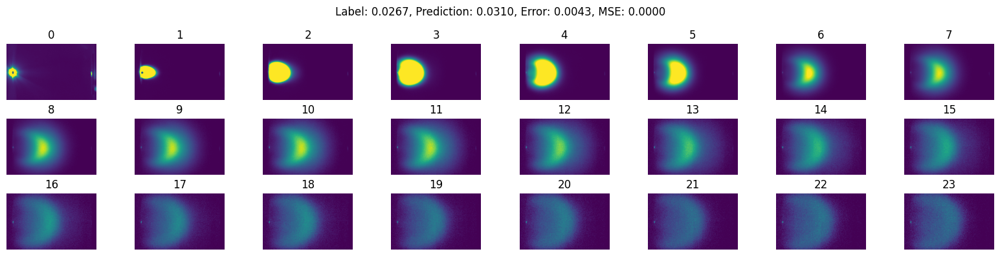

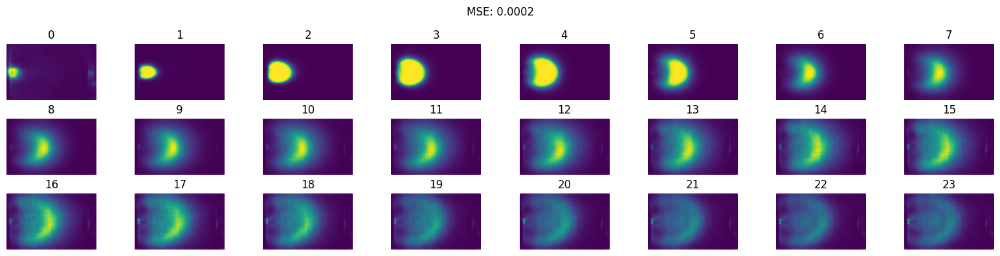

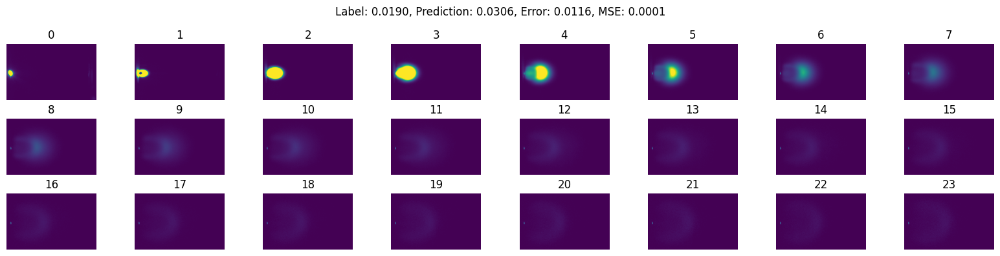

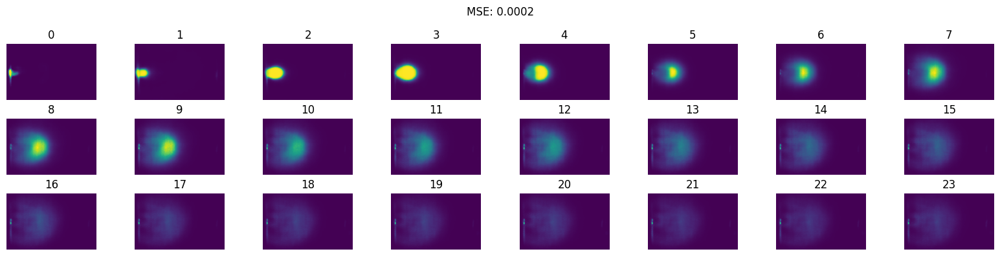

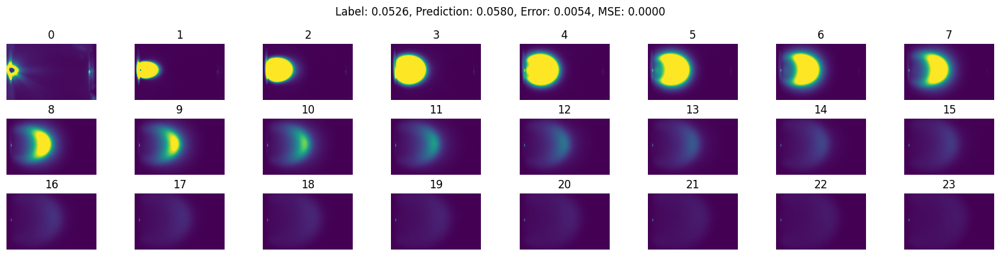

...

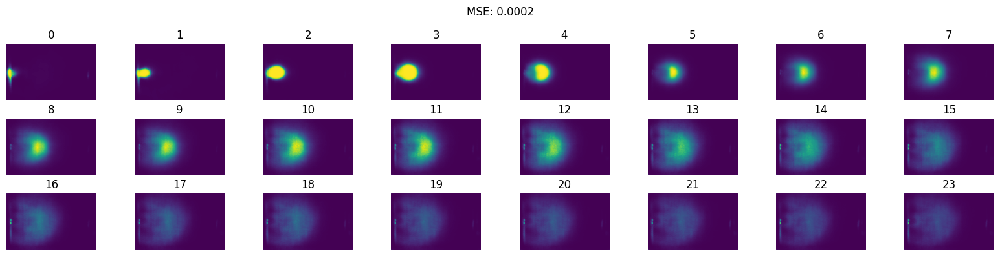

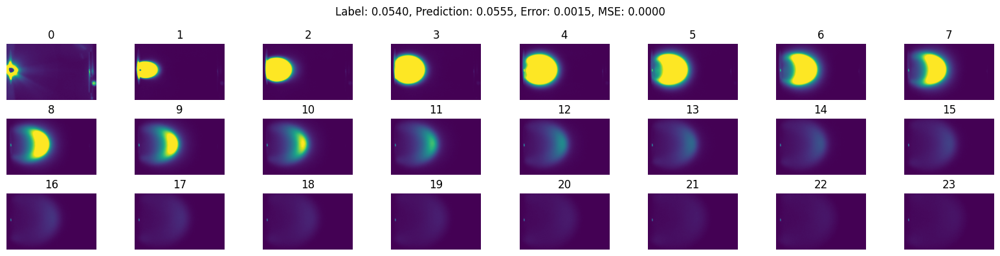

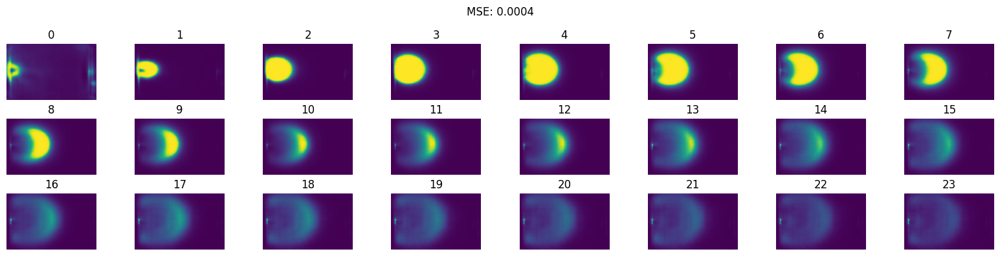

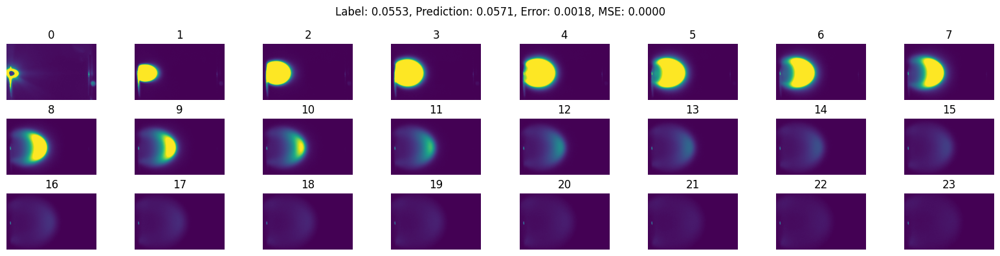

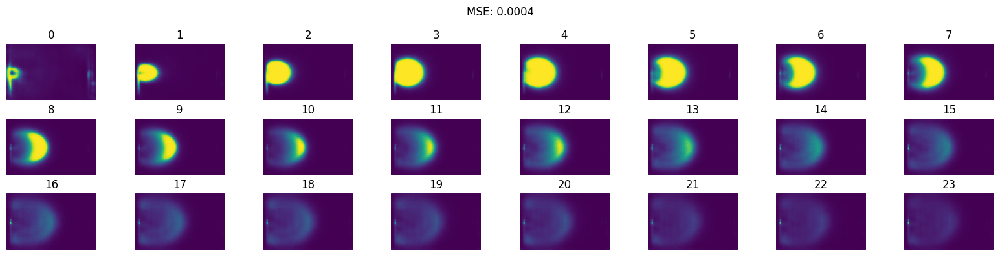

In [5]:
device = torch.device('cuda:0')
loss_func = nn.MSELoss()

batch = next(iter(train_dl))
images, labels = batch
images = images.to(device)
labels = labels.to(device)
model = model.to(device)
gr, reconstructed = model(images)
# images = images.squeeze().cpu().numpy()
# reconstructed = reconstructed.squeeze().cpu().detach().numpy()
print(gr.shape, labels.shape, images.shape, reconstructed.shape)

for i in range(len(images)):
    show_images(images.squeeze().cpu().numpy()[i], title=f'Label: {labels[i].item():.4f}, Prediction: {gr[i].item():.4f}, Error: {gr[i].item()-labels[i].item():.4f}, MSE: {nn.MSELoss()(gr[i], labels[i]).item():.4f}')
    plt.show()
    show_images(reconstructed.squeeze().detach().cpu().numpy()[i], title=f'MSE: {loss_func(reconstructed[i], images[i]).item():.4f}')
    plt.show()

torch.Size([16, 1]) torch.Size([16, 1]) torch.Size([16, 24, 1, 250, 400]) torch.Size([16, 24, 1, 250, 400])


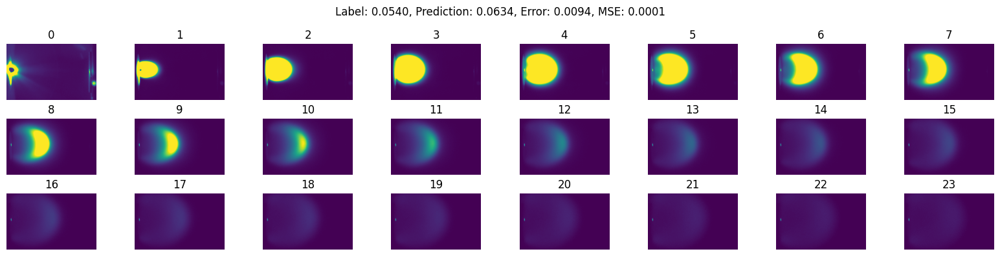

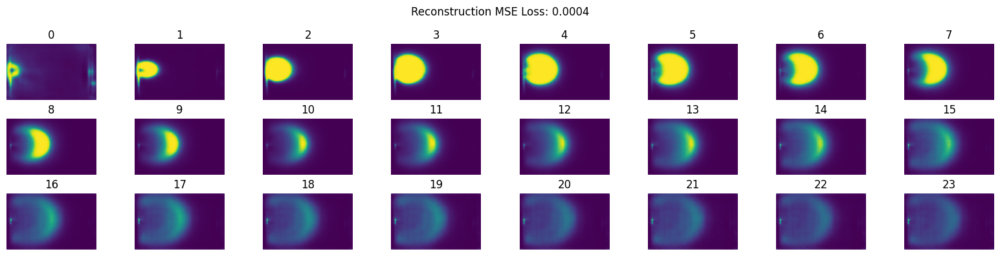

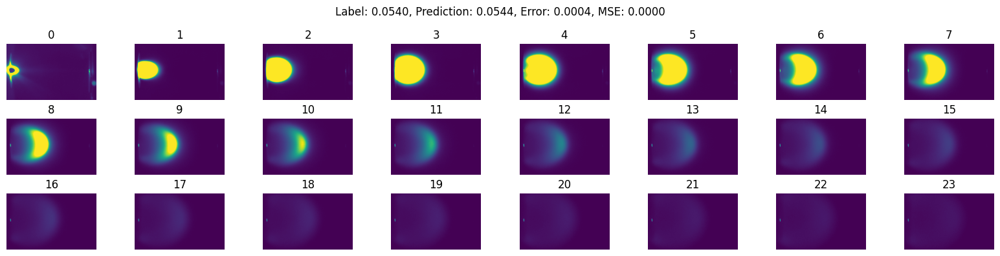

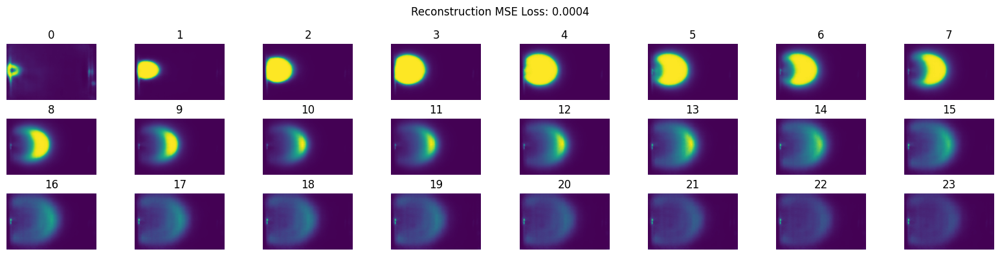

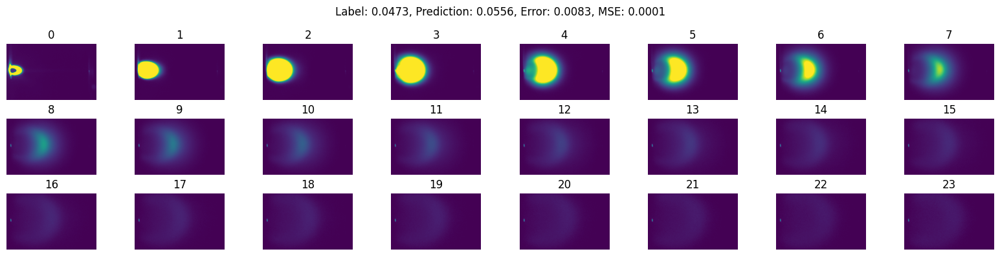

...

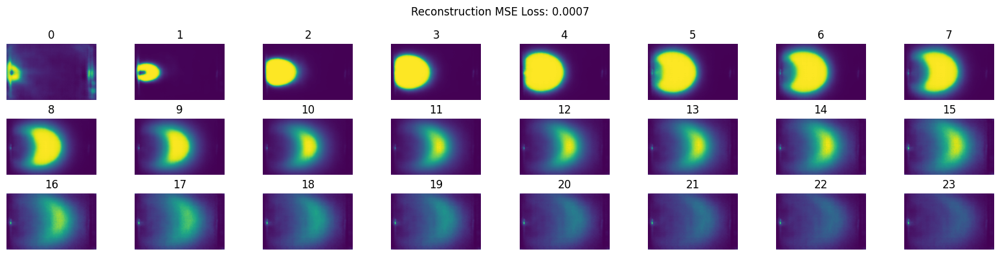

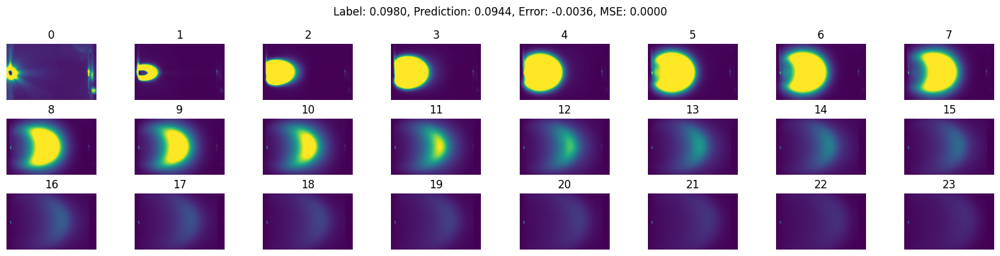

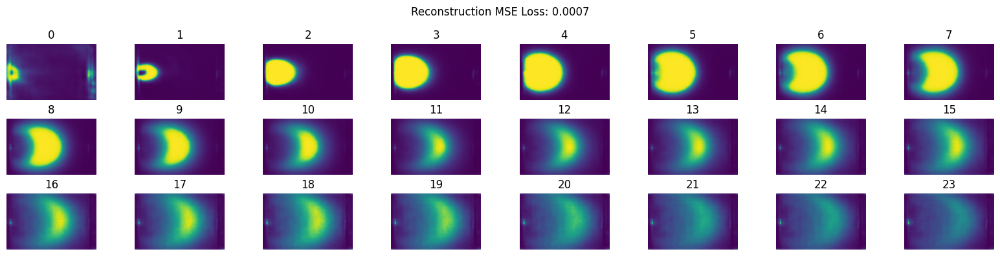

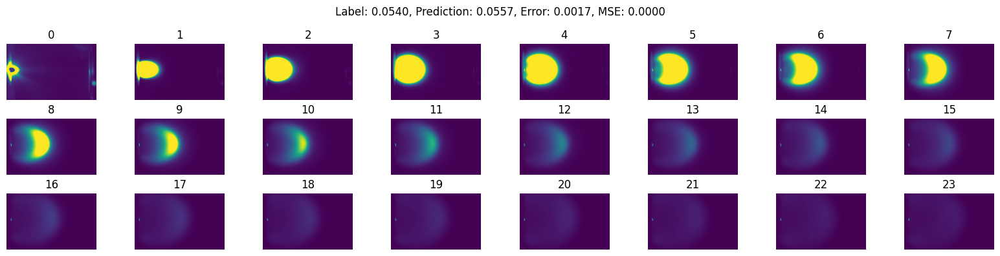

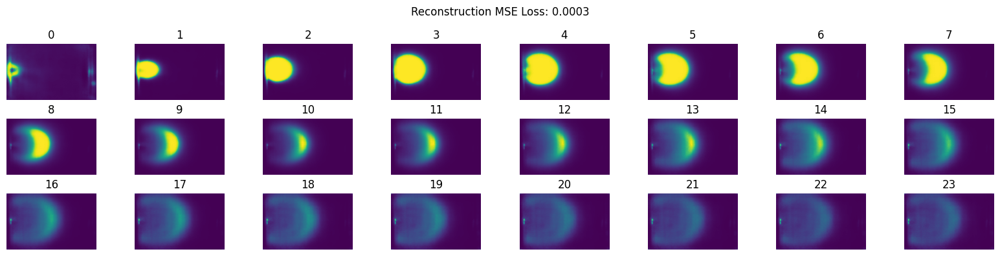

In [6]:
device = torch.device('cuda:1')
loss_func = nn.MSELoss()

batch = next(iter(valid_dl))
images, labels = batch
images = images.to(device)
labels = labels.to(device)
model = model.to(device)
gr, reconstructed = model(images)
# images = images.squeeze().cpu().numpy()
# reconstructed = reconstructed.squeeze().cpu().detach().numpy()
print(gr.shape, labels.shape, images.shape, reconstructed.shape)

for i in range(len(images)):
    show_images(images.squeeze().cpu().numpy()[i], title=f'Label: {labels[i].item():.4f}, Prediction: {gr[i].item():.4f}, Error: {gr[i].item()-labels[i].item():.4f}, MSE: {nn.MSELoss()(gr[i], labels[i]).item():.4f}')
    plt.show()
    show_images(reconstructed.squeeze().detach().cpu().numpy()[i], title=f'Reconstruction MSE Loss: {loss_func(reconstructed[i], images[i]).item():.4f}')
    plt.show()

c:\Users\yig319\Anaconda3\envs\plume\Lib\site-packages\torch\nn\functional.py:5504: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at ..\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:455.)
  attn_output = scaled_dot_product_attention(q, k, v, attn_mask, dropout_p, is_causal)


torch.Size([16, 1]) torch.Size([16, 1]) torch.Size([16, 24, 1, 250, 400]) torch.Size([16, 24, 1, 250, 400])


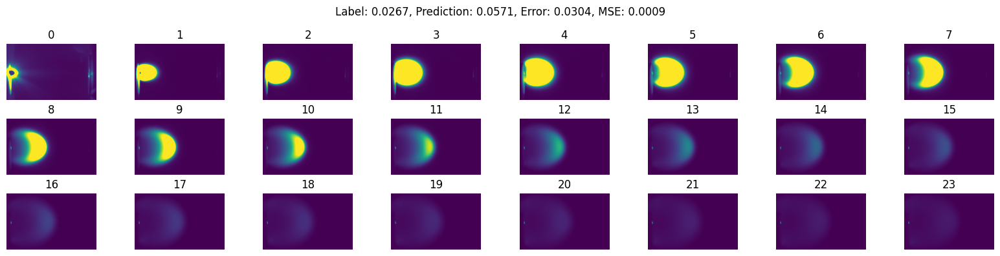

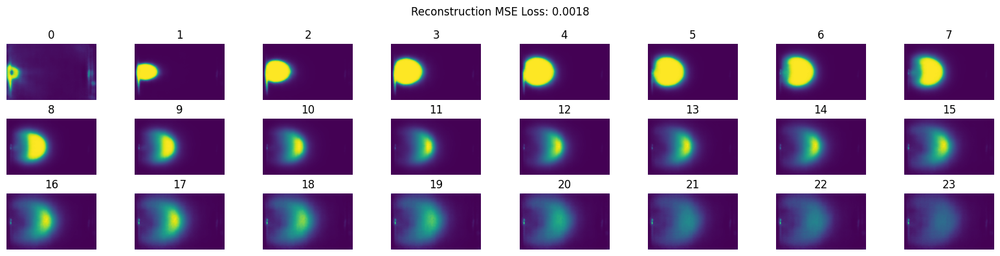

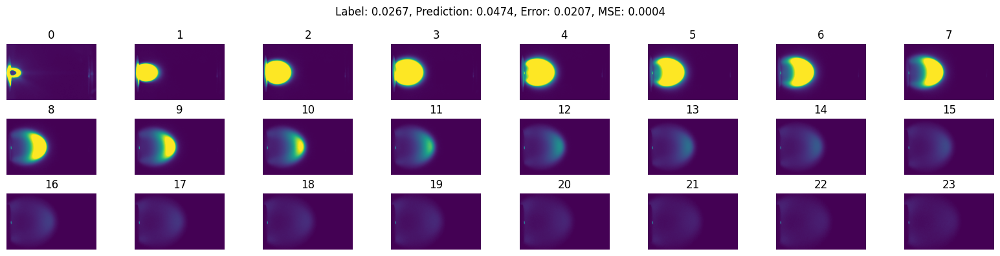

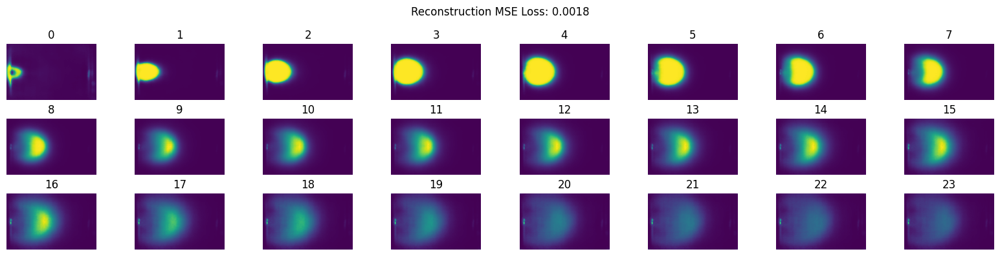

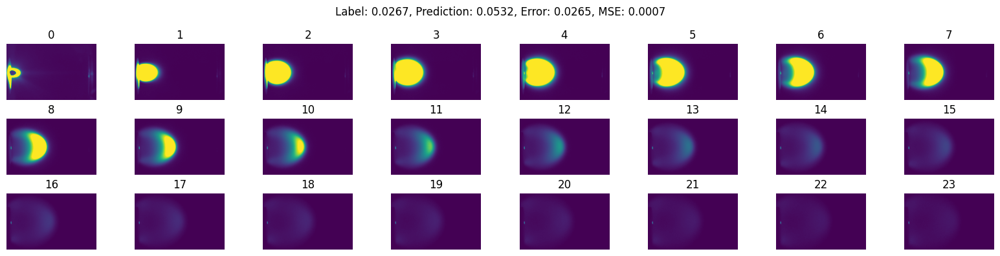

...

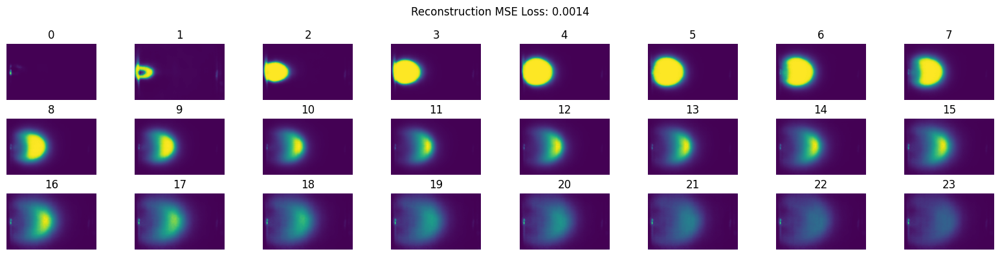

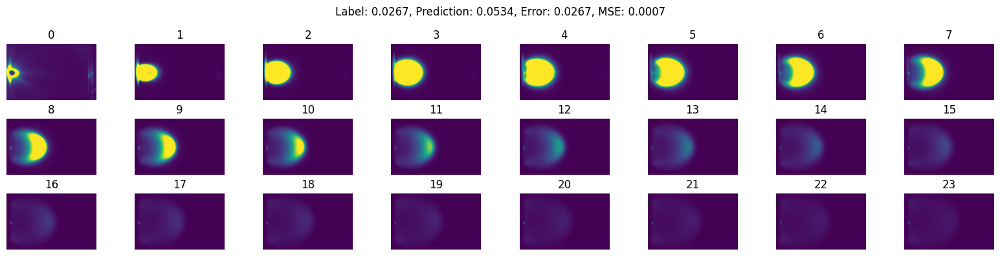

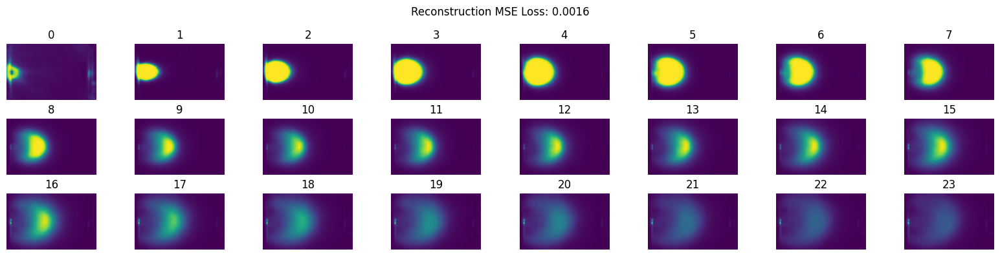

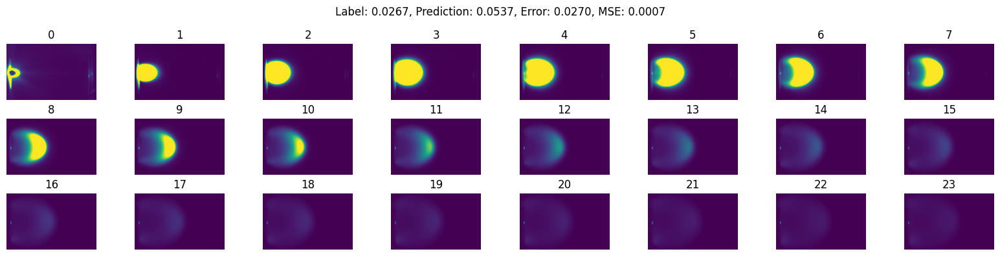

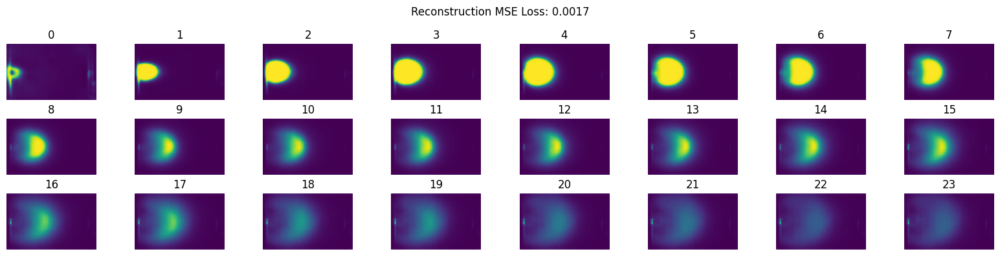

In [5]:
device = torch.device('cuda:0')
loss_func = nn.MSELoss()

batch = next(iter(test_dl))
images, labels = batch
images = images.to(device)
labels = labels.to(device)
model = model.to(device)
gr, reconstructed = model(images)
# images = images.squeeze().cpu().numpy()
# reconstructed = reconstructed.squeeze().cpu().detach().numpy()
print(gr.shape, labels.shape, images.shape, reconstructed.shape)

for i in range(len(images)):
    show_images(images.squeeze().cpu().numpy()[i], title=f'Label: {labels[i].item():.4f}, Prediction: {gr[i].item():.4f}, Error: {gr[i].item()-labels[i].item():.4f}, MSE: {nn.MSELoss()(gr[i], labels[i]).item():.4f}')
    plt.show()
    show_images(reconstructed.squeeze().detach().cpu().numpy()[i], title=f'Reconstruction MSE Loss: {loss_func(reconstructed[i], images[i]).item():.4f}')
    plt.show()